<a href="https://colab.research.google.com/github/jeffheaton/t81_558_deep_learning/blob/master/t81_558_class_07_2_train_gan.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# T81-558: Applications of Deep Neural Networks
**Module 7: Generative Adversarial Networks**
* Instructor: [Jeff Heaton](https://sites.wustl.edu/jeffheaton/), McKelvey School of Engineering, [Washington University in St. Louis](https://engineering.wustl.edu/Programs/Pages/default.aspx)
* For more information visit the [class website](https://sites.wustl.edu/jeffheaton/t81-558/).

# Module 7 Material

* Part 7.1: Introduction to GANs for Image and Data Generation [[Video]](https://www.youtube.com/watch?v=hZw-AjbdN5k&list=PLjy4p-07OYzulelvJ5KVaT2pDlxivl_BN) [[Notebook]](https://github.com/jeffheaton/t81_558_deep_learning/blob/master/t81_558_class_07_1_gan_intro.ipynb)
* **Part 7.2: Train StyleGAN3 with your Own Images** [[Video]](https://www.youtube.com/watch?v=R546LYsQk5M&list=PLjy4p-07OYzulelvJ5KVaT2pDlxivl_BN) [[Notebook]](https://github.com/jeffheaton/t81_558_deep_learning/blob/master/t81_558_class_07_2_train_gan.ipynb)
* Part 7.3: Exploring the StyleGAN Latent Vector [[Video]](https://www.youtube.com/watch?v=goQzp8QSb2s&list=PLjy4p-07OYzulelvJ5KVaT2pDlxivl_BN) [[Notebook]](https://github.com/jeffheaton/t81_558_deep_learning/blob/master/t81_558_class_07_3_latent_vector.ipynb)
* Part 7.4: GANs to Enhance Old Photographs Deoldify [[Video]](https://www.youtube.com/watch?v=0OTd5GlHRx4&list=PLjy4p-07OYzulelvJ5KVaT2pDlxivl_BN) [[Notebook]](https://github.com/jeffheaton/t81_558_deep_learning/blob/master/t81_558_class_07_4_deoldify.ipynb)
* Part 7.5: GANs for Tabular Synthetic Data Generation [[Video]](https://www.youtube.com/watch?v=yujdA46HKwA&list=PLjy4p-07OYzulelvJ5KVaT2pDlxivl_BN) [[Notebook]](https://github.com/jeffheaton/t81_558_deep_learning/blob/master/t81_558_class_07_5_tabular_synthetic.ipynb)


# Google CoLab Instructions

The following code ensures that Google CoLab is running the correct version of TensorFlow.

In [ ]:

try:
    from google.colab import drive
    drive.mount('/content/drive', force_remount=True)
    COLAB = True
    print("Note: using Google CoLab")
    %tensorflow_version 2.x
except:
    print("Note: not using Google CoLab")
    COLAB = False

Mounted at /content/drive
Note: using Google CoLab
Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.


In [ ]:
!pip uninstall tensorflow
!pip install tensorflow

Found existing installation: tensorflow 2.9.2
Uninstalling tensorflow-2.9.2:
  Would remove:
    /usr/local/bin/estimator_ckpt_converter
    /usr/local/bin/import_pb_to_tensorboard
    /usr/local/bin/saved_model_cli
    /usr/local/bin/tensorboard
    /usr/local/bin/tf_upgrade_v2
    /usr/local/bin/tflite_convert
    /usr/local/bin/toco
    /usr/local/bin/toco_from_protos
    /usr/local/lib/python3.7/dist-packages/tensorflow-2.9.2.dist-info/*
    /usr/local/lib/python3.7/dist-packages/tensorflow/*
Proceed (y/n)? y
  Successfully uninstalled tensorflow-2.9.2
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 588.3 MB 6.2 kB/s 
     |████████████████████████████████| 1.7 MB 69.8 MB/s 
     |████████████████████████████████| 6.0 MB 75.2 MB/s 
     |████████████████████████████████| 439 kB 84.1 MB/s 
  Attempting uninstall: tensorflow-estimator
    Found existing installation: tensorflow-estimator 2.9.0


# Part 7.2: Train StyleGAN3 with your Images

Training GANs with StyleGAN is resource-intensive. The NVIDA StyleGAN researchers used computers with eight high-end GPUs for the high-resolution face GANs trained by NVIDIA. The GPU used by NVIDIA is an A100, which has more memory and cores than the P100 or V100 offered by even Colab Pro+. In this part, we will use StyleGAN2 to train rather than StyleGAN3. You can use networks trained with StyleGAN2 from StyleGAN3; however, StyleGAN3 usually is more effective at training than StyleGAN2.

Unfortunately, StyleGAN3 is compute-intensive and will perform slowly on any GPU that is not the latest Ampere technology. Because Colab does not provide such technology, I am keeping the training guide at the StyleGAN2 level. Switching to StyleGAN3 is relatively easy, as will be pointed out later. 

Make sure that you are running this notebook with a GPU runtime. You can train GANs with either Google Colab Free or Pro. I recommend at least the Pro version due to better GPU instances, longer runtimes, and timeouts. Additionally, the capability of Google Colab Pro to run in the background is valuable when training GANs, as you can close your browser or reboot your laptop while training continues.



You will store your training data and trained neural networks to GDRIVE. For GANs, I lay out my GDRIVE like this:

* ./data/gan/images - RAW images I wish to train on.
* ./data/gan/datasets - Actual training datasets that I convert from the raw images.
* ./data/gan/experiments - The output from StyleGAN2, my image previews, and saved network snapshots.

You will mount the drive at the following location.

```
/content/drive/MyDrive/data
```

## What Sort of GPU do you Have?

The type of GPU assigned to you by Colab will significantly affect your training time. Some sample times that I achieved with Colab are given here. I've found that Colab Pro generally starts you with a V100, however, if you run scripts non-stop for 24hrs straight for a few days in a row, you will generally be throttled back to a P100.

* 1024x1024 - V100 - 566 sec/tick (CoLab Pro)
* 1024x1024 - P100 - 1819 sec/tick (CoLab Pro)
* 1024x1024 - T4 - 2188 sec/tick (CoLab Free)

By comparison, a 1024x1024 GAN trained with StyleGAN3 on a V100 is 3087 sec/tick.

If you use Google CoLab Pro, generally, it will not disconnect before 24 hours, even if you (but not your script) are inactive. Free CoLab WILL disconnect a perfectly good running script if you do not interact for a few hours. The following describes how to circumvent this issue.

* [How to prevent Google Colab from disconnecting?](https://stackoverflow.com/questions/57113226/how-to-prevent-google-colab-from-disconnecting)

## Set Up New Environment

You will likely need to train for >24 hours. Colab will disconnect you. You must be prepared to restart training when this eventually happens. Training is divided into ticks, every so many ticks (50 by default), your neural network is evaluated, and a snapshot is saved. When CoLab shuts down, all training after the last snapshot is lost. It might seem desirable to snapshot after each tick; however, this snapshotting process itself takes nearly an hour. Learning an optimal snapshot size for your resolution and training data is important.

We will mount GDRIVE so that you will save your snapshots there. You must also place your training images in GDRIVE.

You must also install NVIDIA StyleGAN2 ADA PyTorch. We also need to downgrade PyTorch to a version that supports StyleGAN.

In [ ]:

!pip install torch==1.8.1 torchvision==0.9.1
!git clone https://github.com/NVlabs/stylegan2-ada-pytorch.git
!pip install ninja

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 804.1 MB 2.5 kB/s 
     |████████████████████████████████| 17.4 MB 22.8 MB/s 
  Attempting uninstall: torch
    Found existing installation: torch 1.12.1+cu113
    Uninstalling torch-1.12.1+cu113:
      Successfully uninstalled torch-1.12.1+cu113
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.13.1+cu113
    Uninstalling torchvision-0.13.1+cu113:
      Successfully uninstalled torchvision-0.13.1+cu113
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchtext 0.13.1 requires torch==1.12.1, but you have torch 1.8.1 which is incompatible.
torchaudio 0.12.1+cu113 requires torch==1.12.1, but you have torch 1.8.1 which is incompatible.
Cloning into 'stylegan2-ada-pytorch'...
remote: Enumerating o

## Find Your Files

The drive is mounted to the following location.

```
/content/drive/MyDrive/data
```

It might be helpful to use an ```ls``` command to establish the exact path for your images.

In [ ]:
!ls /content/drive/MyDrive/maps

1200x-1-1.jpg  IMG_9476.JPG  IMG_9494.JPG  IMG_9507.JPG  IMG_9952.jpg
1200x-1-2.jpg  IMG_9477.JPG  IMG_9495.JPG  IMG_9941.jpg  IMG_9953.jpg
1200x-1-3.jpg  IMG_9478.JPG  IMG_9496.JPG  IMG_9942.jpg  IMG_9954.jpg
1200x-1-4.jpg  IMG_9480.JPG  IMG_9497.JPG  IMG_9943.jpg  IMG_9955.jpg
1200x-1.jpg    IMG_9485.jpg  IMG_9498.JPG  IMG_9944.jpg  IMG_9960.jpg
-1x-1-1.jpg    IMG_9486.jpg  IMG_9499.JPG  IMG_9945.jpg  IMG_9961.jpg
-1x-1.jpg      IMG_9487.jpg  IMG_9500.JPG  IMG_9946.jpg  IMG_9962.jpg
IMG_9469.JPG   IMG_9488.jpg  IMG_9501.JPG  IMG_9947.jpg  IMG_9963.jpg
IMG_9470.JPG   IMG_9489.jpg  IMG_9502.JPG  IMG_9948.jpg  IMG_9964.jpg
IMG_9471.JPG   IMG_9490.jpg  IMG_9503.JPG  IMG_9949.jpg  IMG_9965.jpg
IMG_9472.JPG   IMG_9492.JPG  IMG_9504.JPG  IMG_9950.jpg  IMG_9966.jpg
IMG_9473.JPG   IMG_9493.JPG  IMG_9506.JPG  IMG_9951.jpg  IMG_9967.jpg


In [ ]:
from os import listdir
from os.path import isfile, join
import os
from PIL import Image
from tqdm.notebook import tqdm

imgs = []
path = "/content/drive/MyDrive/maps"
new_path = "/content/drive/MyDrive/images"
valid_images = [".jpg",".gif",".png",".tga",".jpeg"]
size = 512

for i,f in enumerate(os.listdir(path)):
    ext = os.path.splitext(f)[1]
    if ext.lower() not in valid_images:
        continue
    
    img = Image.open(os.path.join(path,f))
    w,h = img.size
    filename = str(i) + ".jpg"
    print(filename)
    if w==h:
        img.resize((size,size)).convert('RGB').save(os.path.join(new_path,filename))
    
    elif w>h:
        img.crop(((w-h)/2,0,(w-h)/2+h,h)).resize((size,size)).convert('RGB').save(os.path.join(new_path,filename))
    
    elif h>w:
        img.crop((0,(h-w)/2,w,(h-w)/2+w)).resize((size,size)).convert('RGB').save(os.path.join(new_path,filename))
        
        


0.jpg
1.jpg
2.jpg
3.jpg
4.jpg
5.jpg
6.jpg
7.jpg
8.jpg
9.jpg
10.jpg
11.jpg
12.jpg
13.jpg
14.jpg
15.jpg
16.jpg
17.jpg
18.jpg
19.jpg
20.jpg
21.jpg
22.jpg
23.jpg
24.jpg
25.jpg
26.jpg
27.jpg
28.jpg
29.jpg
30.jpg
31.jpg
32.jpg
33.jpg
34.jpg
35.jpg
36.jpg
37.jpg
38.jpg
39.jpg
40.jpg
41.jpg
42.jpg
43.jpg
44.jpg
45.jpg
46.jpg
47.jpg
48.jpg
49.jpg
50.jpg
51.jpg
52.jpg
53.jpg
54.jpg
55.jpg
56.jpg
57.jpg
58.jpg
59.jpg


## Convert Your Images

You must convert your images into a data set form that PyTorch can directly utilize. The following command converts your images and writes the resulting data set to another directory.

In [ ]:
CMD = "python /content/stylegan2-ada-pytorch/dataset_tool.py "\
  "--source /content/drive/MyDrive/images "\
  "--dest /content/drive/MyDrive/data/gan/dataset/circuit"

!{CMD}

python3: can't open file '/content/stylegan2-ada-pytorch/dataset_tool.py': [Errno 2] No such file or directory


You can use the following command to clear out the newly created dataset.  If something goes wrong and you need to clean up your images and rerun the above command, you should delete your partially completed dataset directory.

In [ ]:
#!rm -R /content/drive/MyDrive/data/gan/dataset/circuit/*

## Clean Up your Images

All images must have the same dimensions and color depth.  This code can identify images that have issues.

In [ ]:
from os import listdir
from os.path import isfile, join
import os
from PIL import Image
from tqdm.notebook import tqdm

IMAGE_PATH = '/content/drive/MyDrive/data/gan/dataset/circuit/00000'
files = [f for f in listdir(IMAGE_PATH) if isfile(join(IMAGE_PATH, f))]

base_size = None
for file in tqdm(files):
  file2 = os.path.join(IMAGE_PATH,file)
  img = Image.open(file2)
  sz = img.size
  if base_size and sz!=base_size:
    print(f"Inconsistant size: {file2}")
  elif img.mode!='RGB':
    print(f"Inconsistant color format: {file2}")
  else:
    base_size = sz


  0%|          | 0/60 [00:00<?, ?it/s]

## Perform Initial Training

This code performs the initial training.  Set SNAP low enough to get a snapshot before Colab forces you to quit.

In [ ]:
import os

# Modify these to suit your needs
EXPERIMENTS = "/content/drive/MyDrive/data/gan/experiments"
DATA = "/content/drive/MyDrive/data/gan/dataset/circuit/00000"
SNAP = 10

# Build the command and run it
cmd = f"/usr/bin/python3 /content/stylegan2-ada-pytorch/train.py "\
  f"--snap {SNAP} --outdir {EXPERIMENTS} --data {DATA}"
!{cmd}


Training options:
{
  "num_gpus": 1,
  "image_snapshot_ticks": 10,
  "network_snapshot_ticks": 10,
  "metrics": [
    "fid50k_full"
  ],
  "random_seed": 0,
  "training_set_kwargs": {
    "class_name": "training.dataset.ImageFolderDataset",
    "path": "/content/drive/MyDrive/data/gan/dataset/circuit/00000",
    "use_labels": false,
    "max_size": 60,
    "xflip": false,
    "resolution": 512
  },
  "data_loader_kwargs": {
    "pin_memory": true,
    "num_workers": 3,
    "prefetch_factor": 2
  },
  "G_kwargs": {
    "class_name": "training.networks.Generator",
    "z_dim": 512,
    "w_dim": 512,
    "mapping_kwargs": {
      "num_layers": 2
    },
    "synthesis_kwargs": {
      "channel_base": 32768,
      "channel_max": 512,
      "num_fp16_res": 4,
      "conv_clamp": 256
    }
  },
  "D_kwargs": {
    "class_name": "training.networks.Discriminator",
    "block_kwargs": {},
    "mapping_kwargs": {},
    "epilogue_kwargs": {
      "mbstd_group_size": 4
    },
    "channel_base": 3



















## Resume Training

You can now resume training after you are interrupted by something in the pervious step.

In [ ]:
import os

# Modify these to suit your needs
EXPERIMENTS = "/content/drive/MyDrive/data/gan/experiments"
NETWORK = "network-snapshot-000240.pkl"
RESUME = os.path.join(EXPERIMENTS, \
                "00003-00000-auto1-resumecustom", NETWORK)
DATA = "/content/drive/MyDrive/data/gan/dataset/circuit"
SNAP = 10

# Build the command and run it
cmd = f"/usr/bin/python3 /content/stylegan2-ada-pytorch/train.py "\
  f"--snap {SNAP} --resume {RESUME} --outdir {EXPERIMENTS} --data {DATA}"
!{cmd}|

/bin/bash: -c: line 1: syntax error: unexpected end of file


In [17]:
!git clone https://github.com/NVlabs/stylegan3.git
!pip install ninja

fatal: destination path 'stylegan3' already exists and is not an empty directory.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [18]:
!ls /content/stylegan3

avg_spectra.py	 Dockerfile	  gen_video.py	metrics      training
calc_metrics.py  docs		  gui_utils	__pycache__  train.py
dataset_tool.py  environment.yml  legacy.py	README.md    visualizer.py
dnnlib		 gen_images.py	  LICENSE.txt	torch_utils  viz


In [19]:
# HIDE OUTPUT
URL = "/content/drive/MyDrive/data/gan/experiments/00003-00000-auto1/network-snapshot-000240.pkl"

!python /content/stylegan3/gen_images.py \
    --network={URL} \
  --outdir=/content/results --seeds=6600-6625 

Loading networks from "/content/drive/MyDrive/data/gan/experiments/00003-00000-auto1/network-snapshot-000240.pkl"...
Generating image for seed 6600 (0/26) ...
Setting up PyTorch plugin "bias_act_plugin"... Done.
Setting up PyTorch plugin "upfirdn2d_plugin"... Done.
Generating image for seed 6601 (1/26) ...
Generating image for seed 6602 (2/26) ...
Generating image for seed 6603 (3/26) ...
Generating image for seed 6604 (4/26) ...
Generating image for seed 6605 (5/26) ...
Generating image for seed 6606 (6/26) ...
Generating image for seed 6607 (7/26) ...
Generating image for seed 6608 (8/26) ...
Generating image for seed 6609 (9/26) ...
Generating image for seed 6610 (10/26) ...
Generating image for seed 6611 (11/26) ...
Generating image for seed 6612 (12/26) ...
Generating image for seed 6613 (13/26) ...
Generating image for seed 6614 (14/26) ...
Generating image for seed 6615 (15/26) ...
Generating image for seed 6616 (16/26) ...
Generating image for seed 6617 (17/26) ...
Generating i

In [20]:
!ls /content/results

frame-0.png    frame-15.png   frame-219.png  frame-279.png  frame-68.png
frame-100.png  frame-160.png  frame-21.png   frame-27.png   frame-69.png
frame-101.png  frame-161.png  frame-220.png  frame-280.png  frame-6.png
frame-102.png  frame-162.png  frame-221.png  frame-281.png  frame-70.png
frame-103.png  frame-163.png  frame-222.png  frame-282.png  frame-71.png
frame-104.png  frame-164.png  frame-223.png  frame-283.png  frame-72.png
frame-105.png  frame-165.png  frame-224.png  frame-284.png  frame-73.png
frame-106.png  frame-166.png  frame-225.png  frame-285.png  frame-74.png
frame-107.png  frame-167.png  frame-226.png  frame-286.png  frame-75.png
frame-108.png  frame-168.png  frame-227.png  frame-287.png  frame-76.png
frame-109.png  frame-169.png  frame-228.png  frame-288.png  frame-77.png
frame-10.png   frame-16.png   frame-229.png  frame-289.png  frame-78.png
frame-110.png  frame-170.png  frame-22.png   frame-28.png   frame-79.png
frame-111.png  frame-171.png  frame-230.png  frame-2

In [21]:
!cp /content/results/* \
    /content/drive/MyDrive/maps_results

cp: target '/content/drive/MyDrive/maps_results' is not a directory


In [ ]:
import sys
sys.path.insert(0, "/content/stylegan3")
import pickle
import os
import numpy as np
import PIL.Image
from IPython.display import Image
import matplotlib.pyplot as plt
import IPython.display
import torch
import dnnlib
import legacy

def seed2vec(G, seed):
  return np.random.RandomState(seed).randn(1, G.z_dim)

def display_image(image):
  plt.axis('off')
  plt.imshow(image)
  plt.show()

def generate_image(G, z, truncation_psi):
    # Render images for dlatents initialized from random seeds.
    Gs_kwargs = {
        'output_transform': dict(func=tflib.convert_images_to_uint8, 
         nchw_to_nhwc=True),
        'randomize_noise': False
    }
    if truncation_psi is not None:
        Gs_kwargs['truncation_psi'] = truncation_psi

    label = np.zeros([1] + G.input_shapes[1][1:])
    # [minibatch, height, width, channel]
    images = G.run(z, label, **G_kwargs) 
    return images[0]

def get_label(G, device, class_idx):
  label = torch.zeros([1, G.c_dim], device=device)
  if G.c_dim != 0:
      if class_idx is None:
          ctx.fail("Must specify class label with --class when using "\
            "a conditional network")
      label[:, class_idx] = 1
  else:
      if class_idx is not None:
          print ("warn: --class=lbl ignored when running on "\
            "an unconditional network")
  return label

def generate_image(device, G, z, truncation_psi=1.0, noise_mode='const', 
                   class_idx=None):
  z = torch.from_numpy(z).to(device)
  label = get_label(G, device, class_idx)
  img = G(z, label, truncation_psi=truncation_psi, noise_mode=noise_mode)
  img = (img.permute(0, 2, 3, 1) * 127.5 + 128).clamp(0, 255).to(\
      torch.uint8)
  return PIL.Image.fromarray(img[0].cpu().numpy(), 'RGB')

In [22]:
#URL = "https://github.com/jeffheaton/pretrained-gan-fish/releases/"\
#  "download/1.0.0/fish-gan-2020-12-09.pkl"
#URL = "https://github.com/jeffheaton/pretrained-merry-gan-mas/releases/"\
#  "download/v1/christmas-gan-2020-12-03.pkl"
URL = "/content/drive/MyDrive/data/gan/experiments/00003-00000-auto1/network-snapshot-000240.pkl"

print(f'Loading networks from "{URL}"...')
device = torch.device('cuda')
with dnnlib.util.open_url(URL) as f:
    G = legacy.load_network_pkl(f)['G_ema'].to(device) # type: ignore

Loading networks from "/content/drive/MyDrive/data/gan/experiments/00003-00000-auto1/network-snapshot-000240.pkl"...


Seed 1000


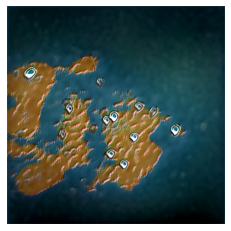

Seed 1001


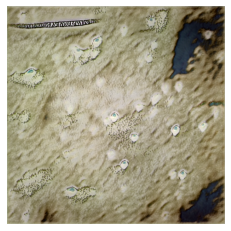

Seed 1002


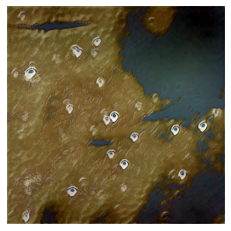

Seed 1003


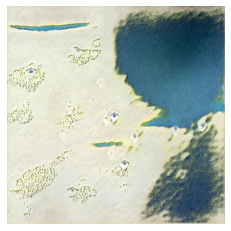

Seed 1004


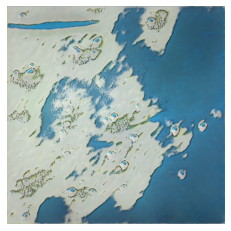

Seed 1005


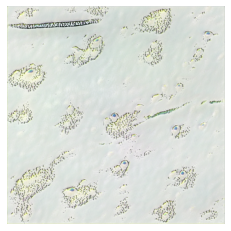

Seed 1006


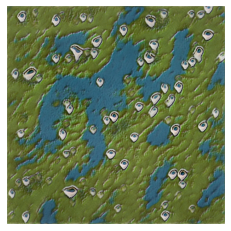

Seed 1007


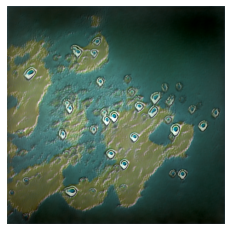

Seed 1008


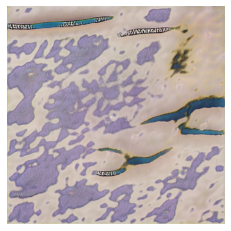

Seed 1009


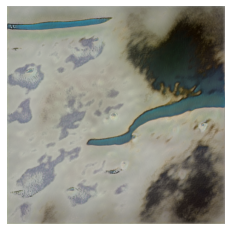

Seed 1010


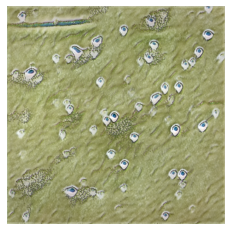

Seed 1011


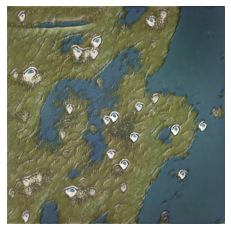

Seed 1012


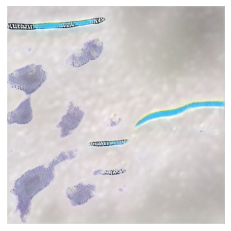

Seed 1013


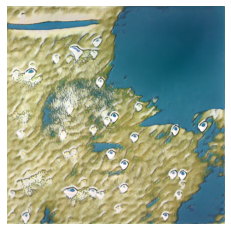

Seed 1014


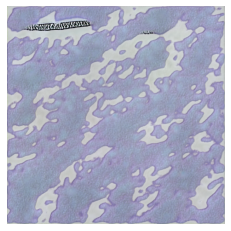

Seed 1015


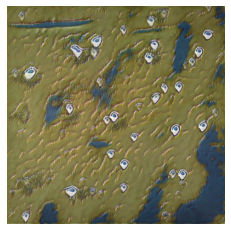

Seed 1016


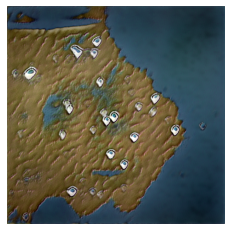

Seed 1017


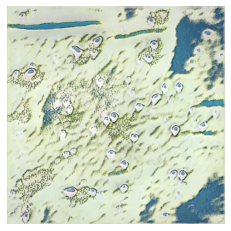

Seed 1018


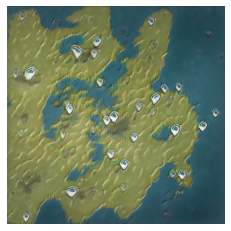

Seed 1019


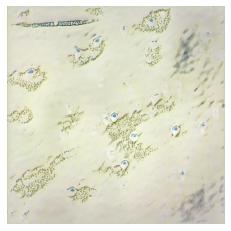

Seed 1020


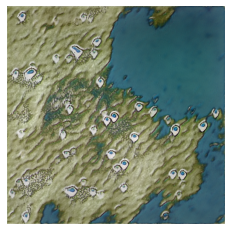

Seed 1021


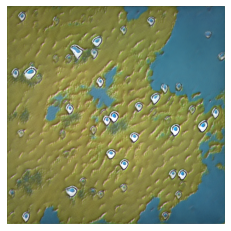

Seed 1022


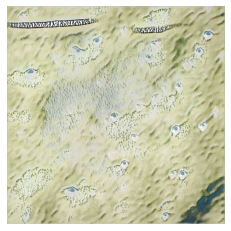

Seed 1023


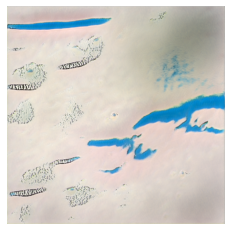

Seed 1024


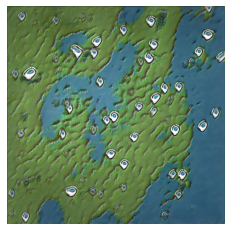

Seed 1025


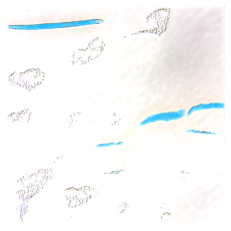

Seed 1026


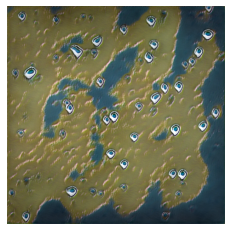

Seed 1027


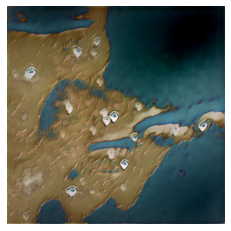

Seed 1028


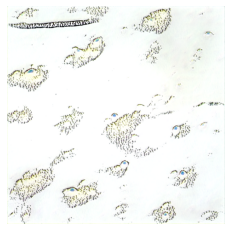

Seed 1029


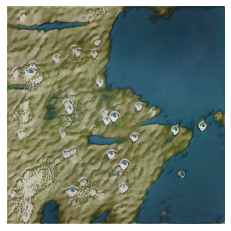

Seed 1030


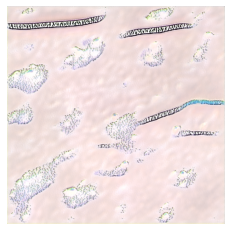

Seed 1031


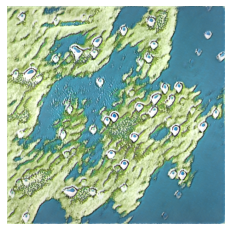

Seed 1032


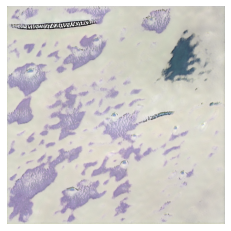

Seed 1033


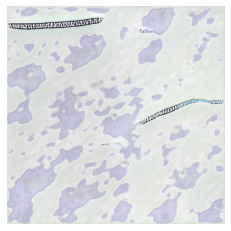

Seed 1034


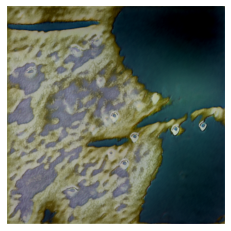

Seed 1035


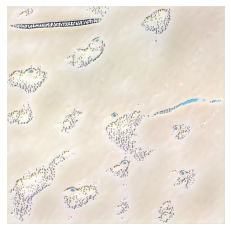

Seed 1036


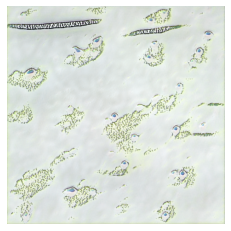

Seed 1037


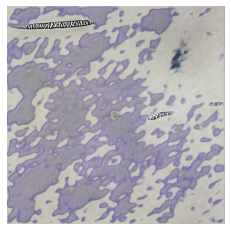

Seed 1038


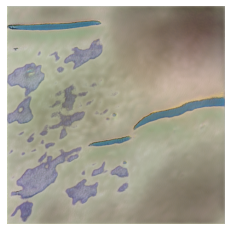

Seed 1039


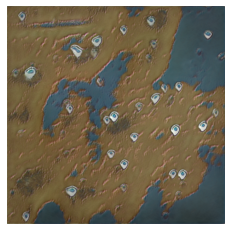

Seed 1040


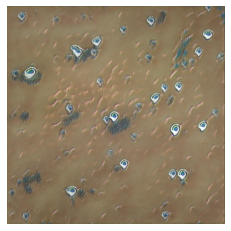

Seed 1041


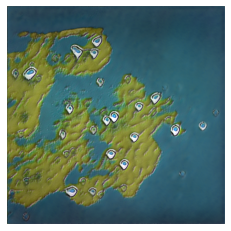

Seed 1042


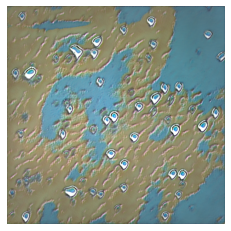

Seed 1043


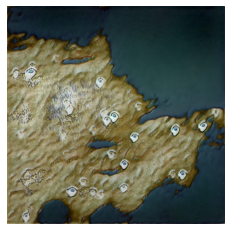

Seed 1044


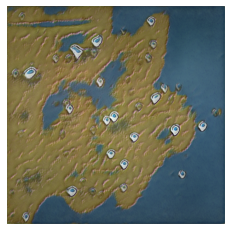

Seed 1045


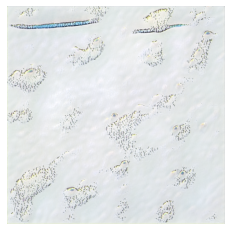

Seed 1046


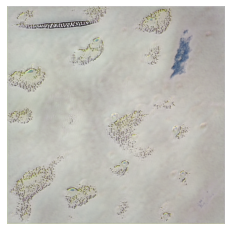

Seed 1047


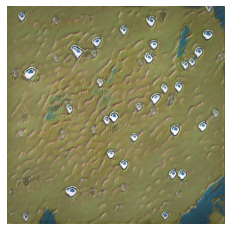

Seed 1048


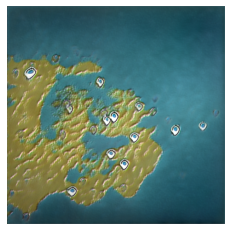

Seed 1049


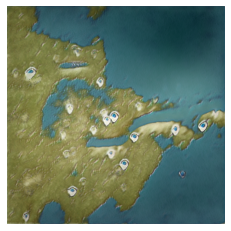

Seed 1050


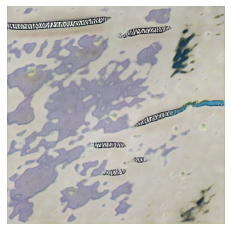

Seed 1051


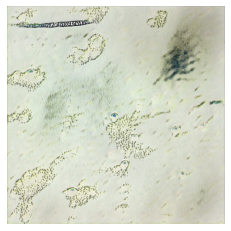

Seed 1052


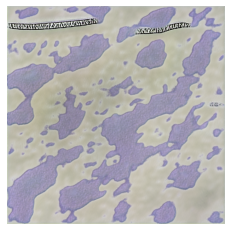

Seed 1053


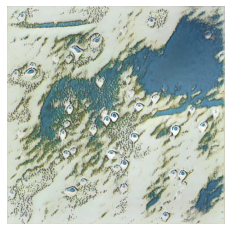

Seed 1054


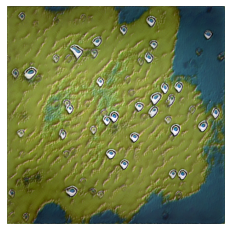

Seed 1055


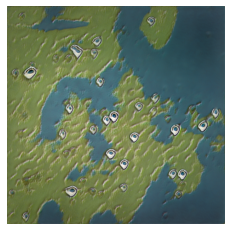

Seed 1056


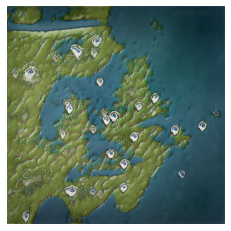

Seed 1057


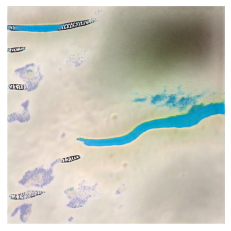

Seed 1058


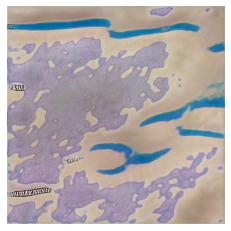

Seed 1059


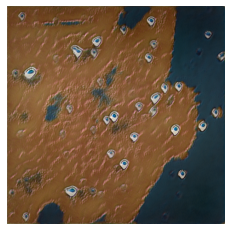

Seed 1060


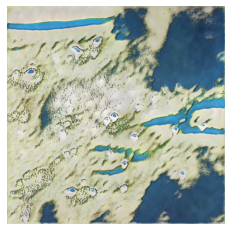

Seed 1061


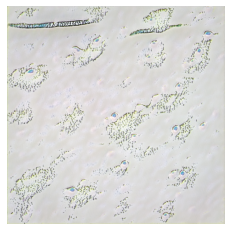

Seed 1062


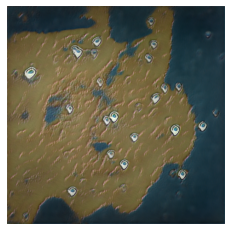

Seed 1063


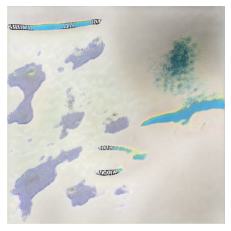

Seed 1064


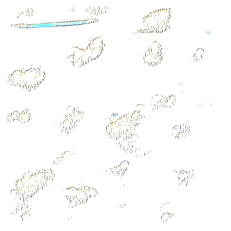

Seed 1065


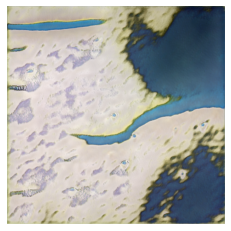

Seed 1066


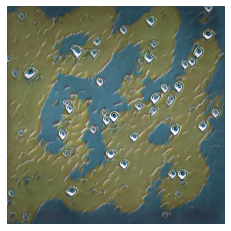

Seed 1067


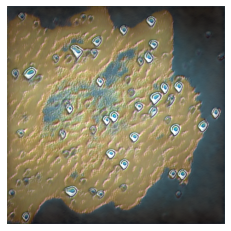

Seed 1068


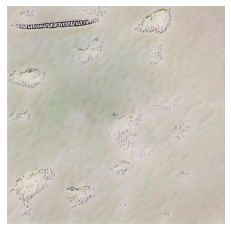

Seed 1069


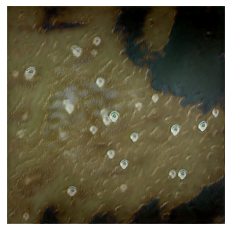

Seed 1070


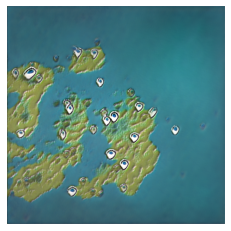

Seed 1071


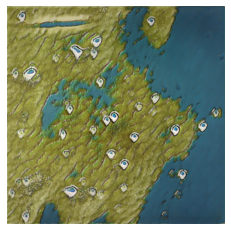

Seed 1072


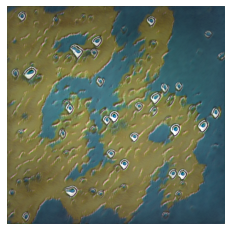

Seed 1073


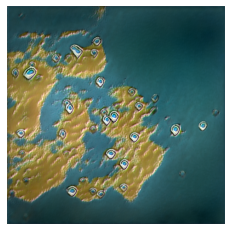

Seed 1074


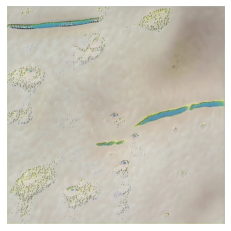

Seed 1075


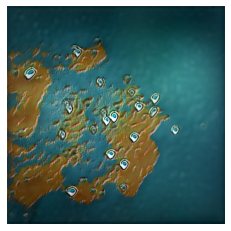

Seed 1076


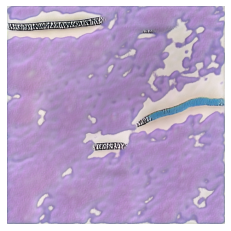

Seed 1077


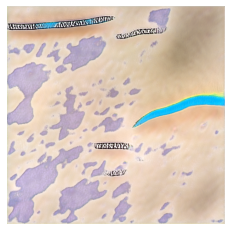

Seed 1078


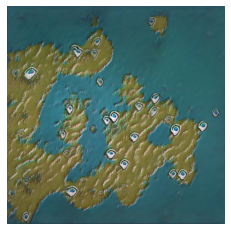

Seed 1079


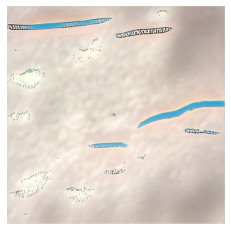

Seed 1080


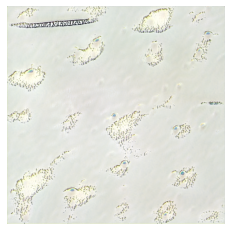

Seed 1081


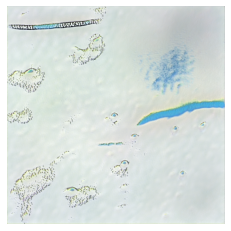

Seed 1082


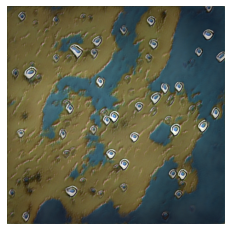

Seed 1083


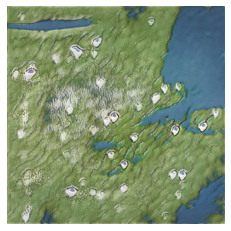

Seed 1084


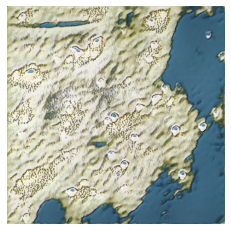

Seed 1085


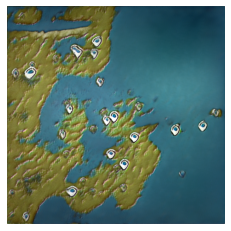

Seed 1086


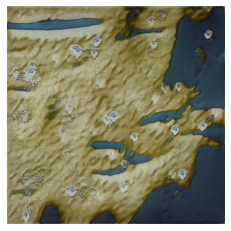

Seed 1087


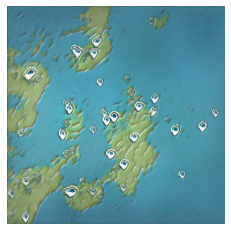

Seed 1088


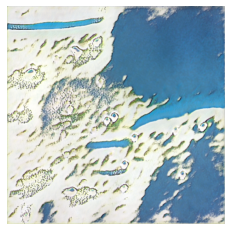

Seed 1089


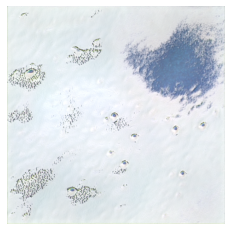

Seed 1090


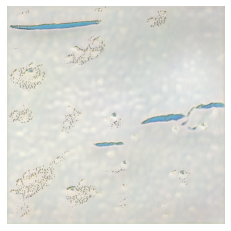

Seed 1091


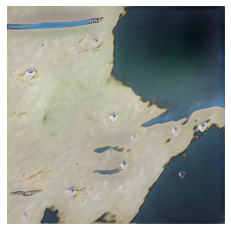

Seed 1092


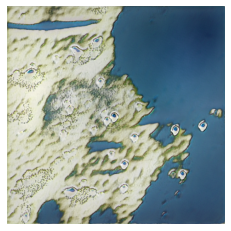

Seed 1093


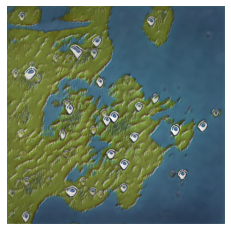

Seed 1094


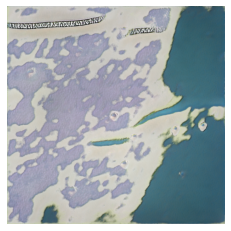

Seed 1095


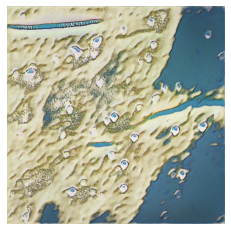

Seed 1096


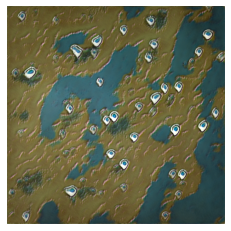

Seed 1097


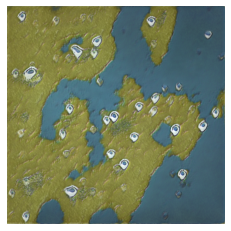

Seed 1098


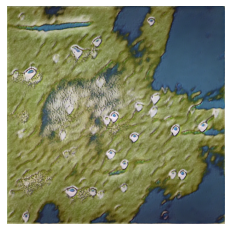

Seed 1099


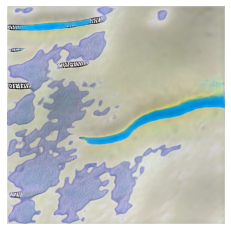

Seed 1100


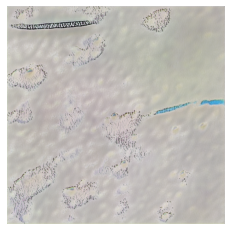

Seed 1101


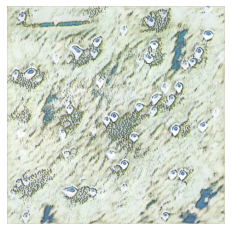

Seed 1102


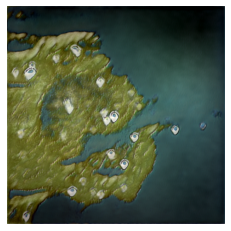

Seed 1103


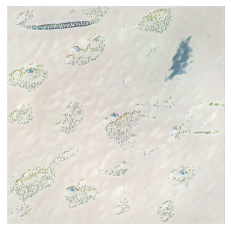

Seed 1104


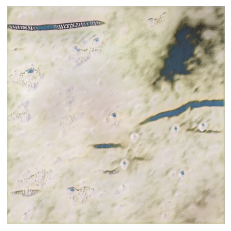

Seed 1105


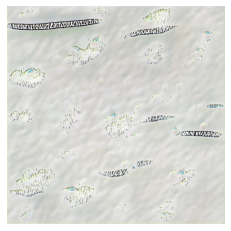

Seed 1106


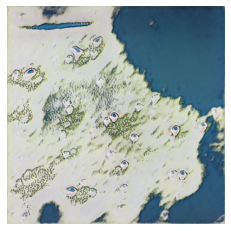

Seed 1107


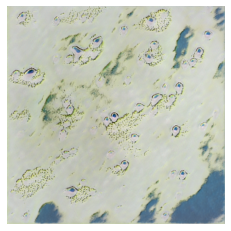

Seed 1108


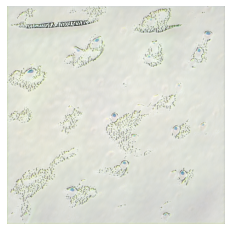

Seed 1109


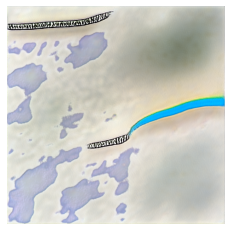

Seed 1110


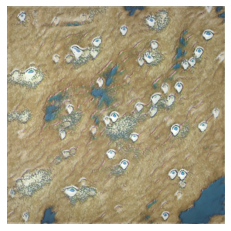

Seed 1111


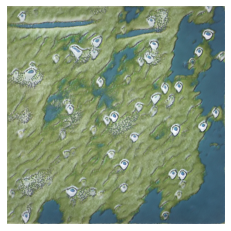

Seed 1112


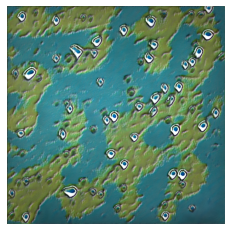

Seed 1113


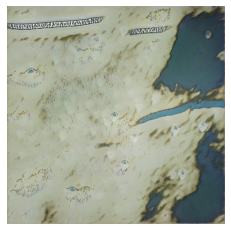

Seed 1114


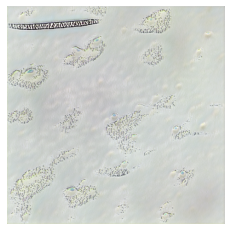

Seed 1115


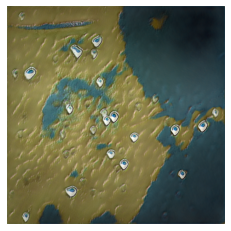

Seed 1116


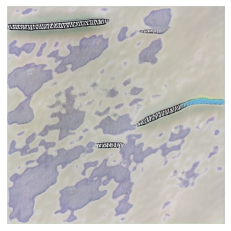

Seed 1117


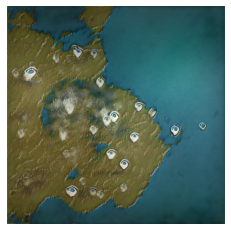

Seed 1118


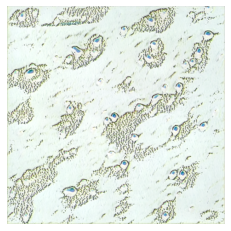

Seed 1119


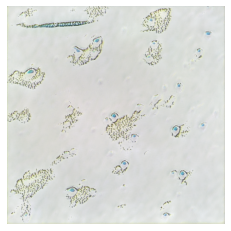

Seed 1120


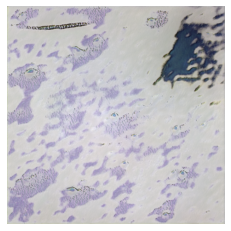

Seed 1121


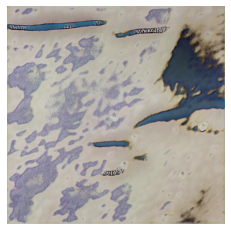

Seed 1122


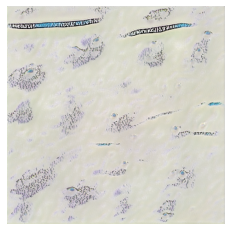

Seed 1123


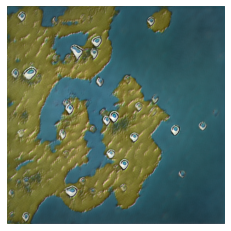

Seed 1124


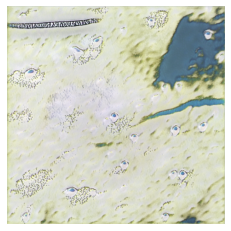

Seed 1125


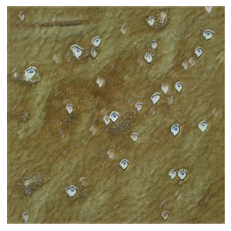

Seed 1126


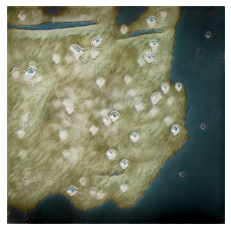

Seed 1127


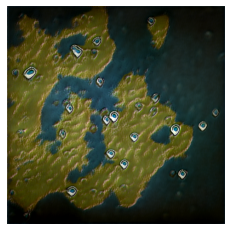

Seed 1128


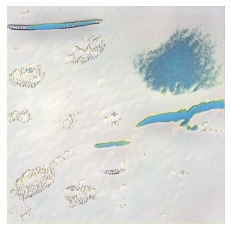

Seed 1129


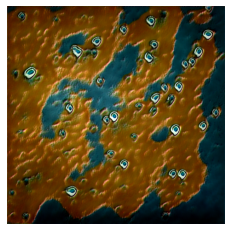

Seed 1130


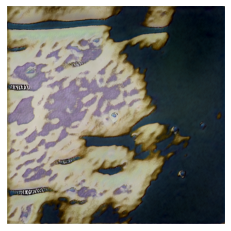

Seed 1131


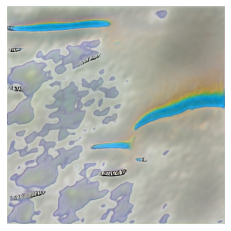

Seed 1132


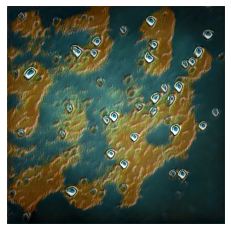

Seed 1133


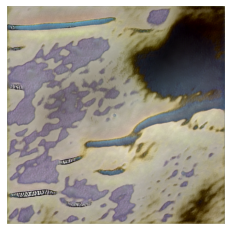

Seed 1134


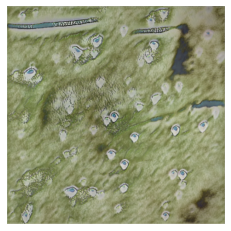

Seed 1135


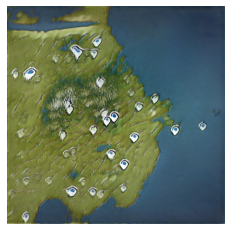

Seed 1136


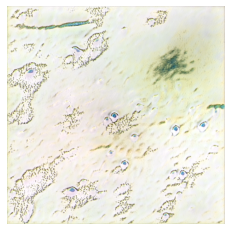

Seed 1137


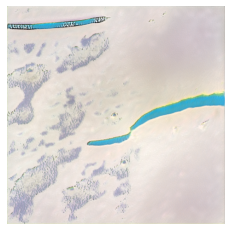

Seed 1138


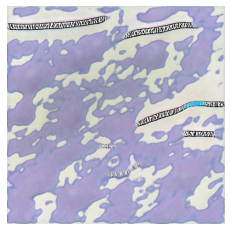

Seed 1139


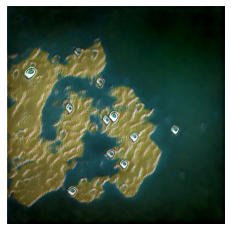

Seed 1140


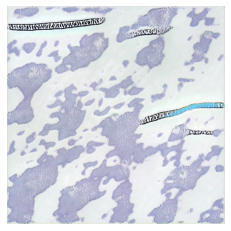

Seed 1141


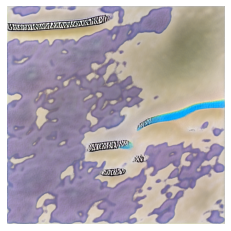

Seed 1142


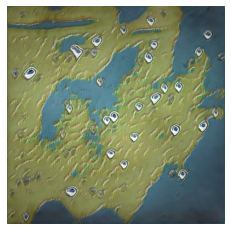

Seed 1143


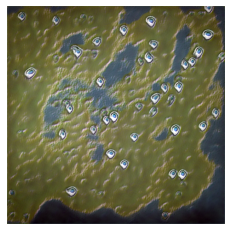

Seed 1144


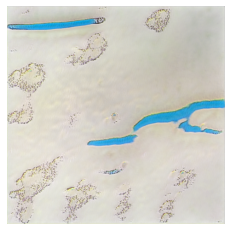

Seed 1145


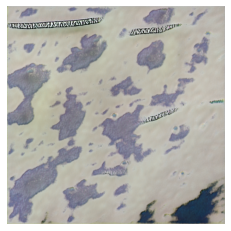

Seed 1146


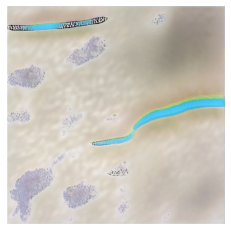

Seed 1147


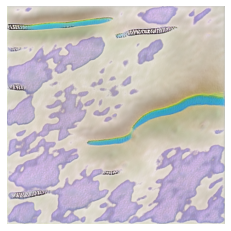

Seed 1148


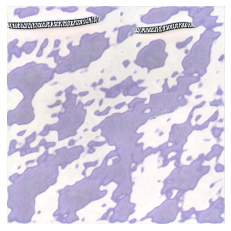

Seed 1149


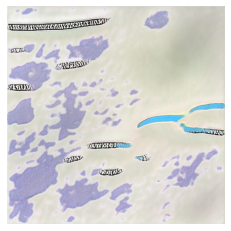

Seed 1150


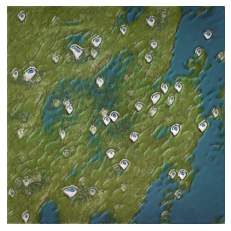

Seed 1151


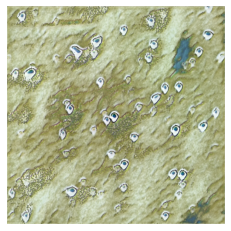

Seed 1152


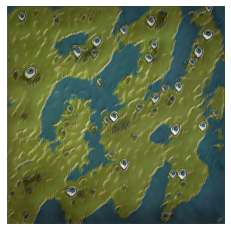

Seed 1153


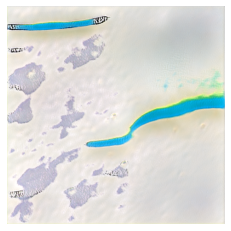

Seed 1154


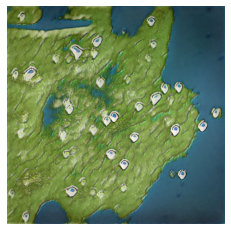

Seed 1155


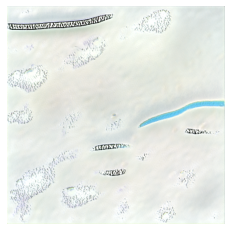

Seed 1156


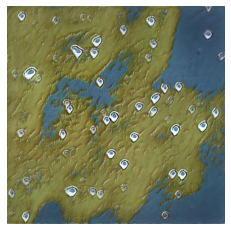

Seed 1157


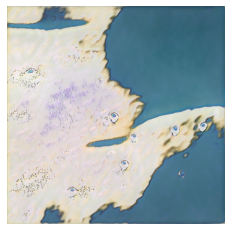

Seed 1158


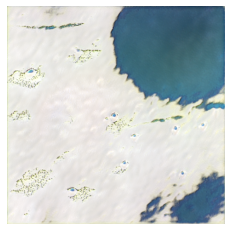

Seed 1159


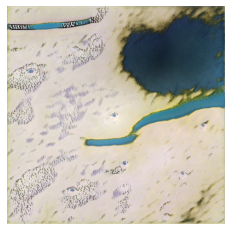

Seed 1160


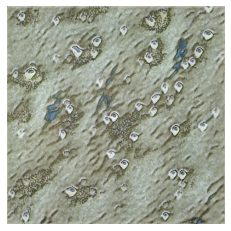

Seed 1161


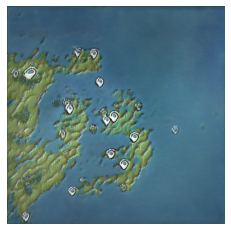

Seed 1162


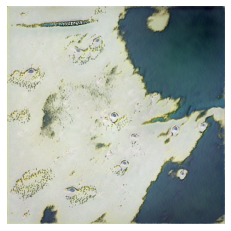

Seed 1163


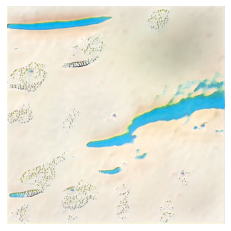

Seed 1164


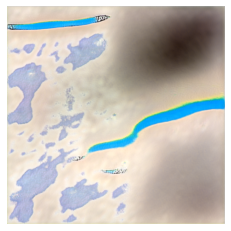

Seed 1165


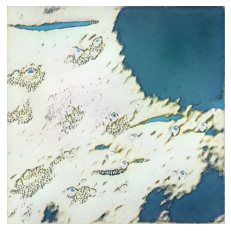

Seed 1166


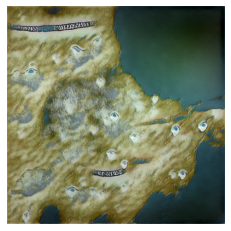

Seed 1167


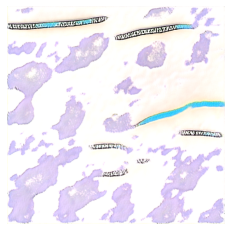

Seed 1168


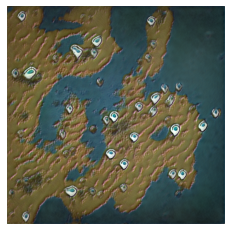

Seed 1169


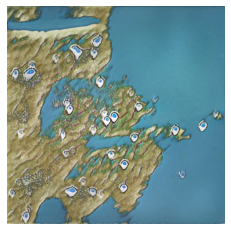

Seed 1170


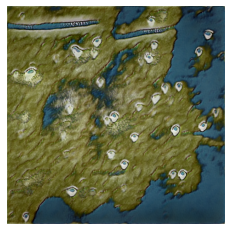

Seed 1171


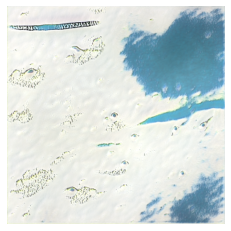

Seed 1172


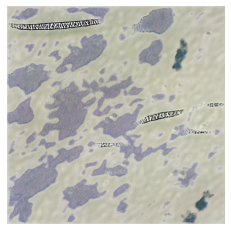

Seed 1173


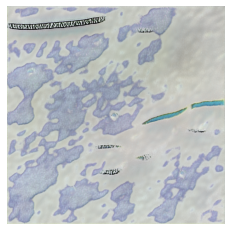

Seed 1174


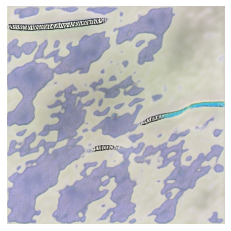

Seed 1175


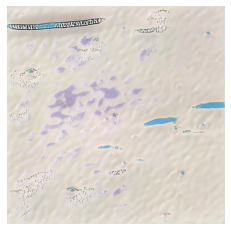

Seed 1176


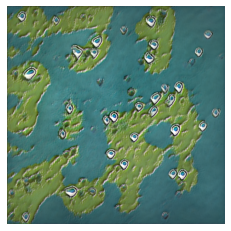

Seed 1177


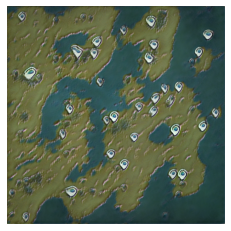

Seed 1178


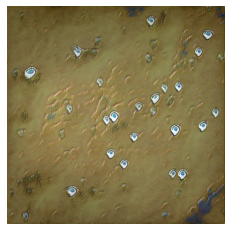

Seed 1179


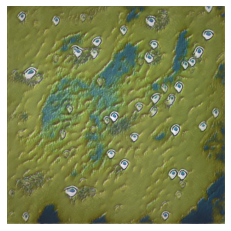

Seed 1180


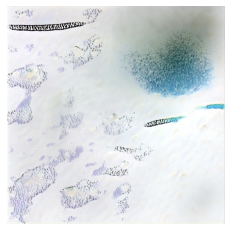

Seed 1181


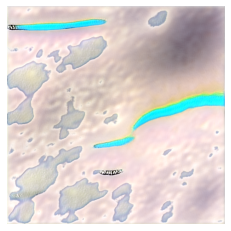

Seed 1182


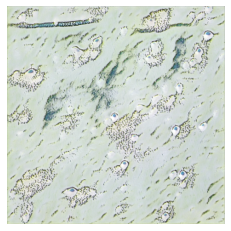

Seed 1183


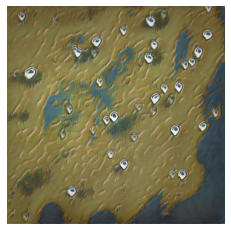

Seed 1184


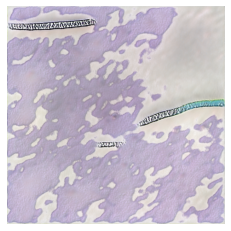

Seed 1185


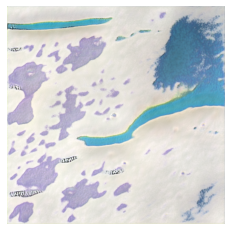

Seed 1186


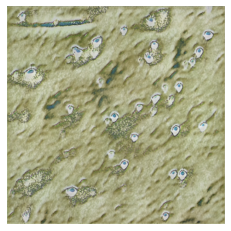

Seed 1187


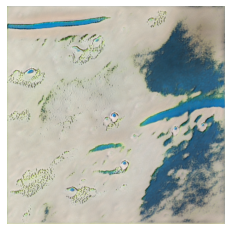

Seed 1188


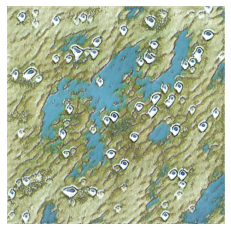

Seed 1189


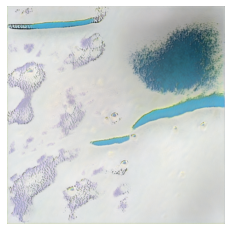

Seed 1190


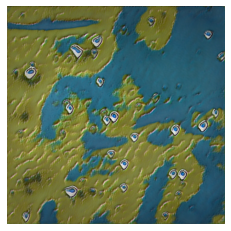

Seed 1191


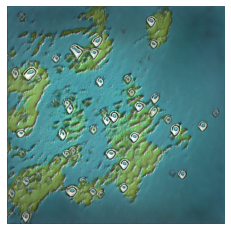

Seed 1192


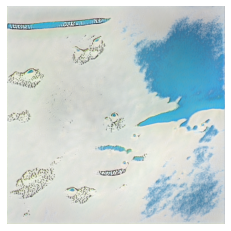

Seed 1193


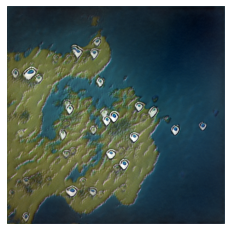

Seed 1194


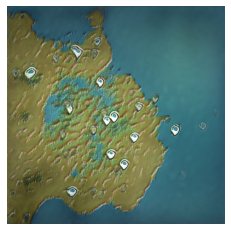

Seed 1195


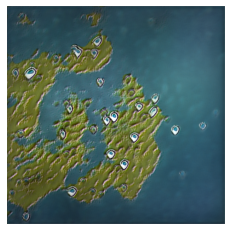

Seed 1196


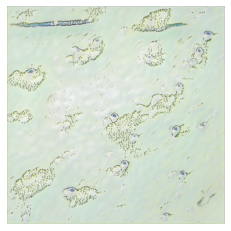

Seed 1197


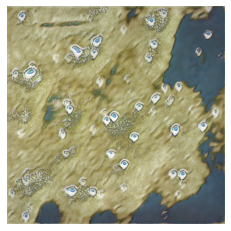

Seed 1198


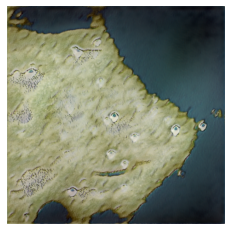

Seed 1199


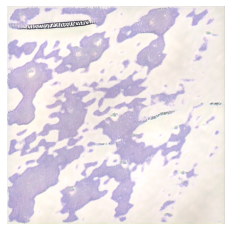

In [24]:
# Choose your own starting and ending seed.
SEED_FROM = 1000
SEED_TO = 1200


# Generate the images for the seeds.
for i in range(SEED_FROM, SEED_TO):
  print(f"Seed {i}")
  z = seed2vec(G, i)
  img = generate_image(device, G, z)
  display_image(img)


In [26]:
def expand_seed(seeds, vector_size):
  result = []

  for seed in seeds:
    rnd = np.random.RandomState(seed)
    result.append( rnd.randn(1, vector_size) ) 
  return result

#URL = "https://github.com/jeffheaton/pretrained-gan-fish/releases/"\
#  "download/1.0.0/fish-gan-2020-12-09.pkl"
#URL = "https://github.com/jeffheaton/pretrained-merry-gan-mas/releases/"\
#  "download/v1/christmas-gan-2020-12-03.pkl"
#URL = "https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada/pretrained/ffhq.pkl"
URL = "/content/drive/MyDrive/data/gan/experiments/00003-00000-auto1/network-snapshot-000240.pkl"

print(f'Loading networks from "{URL}"...')
device = torch.device('cuda')
with dnnlib.util.open_url(URL) as f:
    G = legacy.load_network_pkl(f)['G_ema'].to(device) # type: ignore

vector_size = G.z_dim
# range(8192,8300)
seeds = expand_seed( [8192+1,8192+9], vector_size)
#generate_images(Gs, seeds,truncation_psi=0.5)
print(seeds[0].shape)

Loading networks from "/content/drive/MyDrive/data/gan/experiments/00003-00000-auto1/network-snapshot-000240.pkl"...
(1, 512)


In [27]:
# HIDE OUTPUT
# Choose your seeds to morph through and the number of steps to 
# take to get to each.

#SEEDS = [6624,6618,6616] # Better for faces
SEEDS = [1182,1196,1199,1181,1189,1187,1185,1165,1192,1198] # Better for fish
STEPS = 60

# Remove any prior results
!rm /content/results/* 

from tqdm.notebook import tqdm

os.makedirs("./results/", exist_ok=True)

# Generate the images for the video.
idx = 0
for i in range(len(SEEDS)-1):
  v1 = seed2vec(G, SEEDS[i])
  v2 = seed2vec(G, SEEDS[i+1])

  diff = v2 - v1
  step = diff / STEPS
  current = v1.copy()

  for j in tqdm(range(STEPS), desc=f"Seed {SEEDS[i]}"):
    current = current + step
    img = generate_image(device, G, current)
    img.save(f'./results/frame-{idx}.png')
    idx+=1
 
# Link the images into a video.
!ffmpeg -r 30 -i /content/results/frame-%d.png -vcodec mpeg4 -y movie.mp4


Seed 1182:   0%|          | 0/60 [00:00<?, ?it/s]

Seed 1196:   0%|          | 0/60 [00:00<?, ?it/s]

Seed 1199:   0%|          | 0/60 [00:00<?, ?it/s]

Seed 1181:   0%|          | 0/60 [00:00<?, ?it/s]

Seed 1189:   0%|          | 0/60 [00:00<?, ?it/s]

Seed 1187:   0%|          | 0/60 [00:00<?, ?it/s]

Seed 1185:   0%|          | 0/60 [00:00<?, ?it/s]

Seed 1165:   0%|          | 0/60 [00:00<?, ?it/s]

Seed 1192:   0%|          | 0/60 [00:00<?, ?it/s]

ffmpeg version 3.4.11-0ubuntu0.1 Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-li

In [28]:
from google.colab import files
files.download('movie.mp4')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>